# tree data exploration

In [1]:
import pandas as pd

In [2]:
import os

print(os.path.exists('data/treeppl5.csv'))

True


In [3]:
print(os.getcwd())

/home/jovyan/221finalproject


In [4]:
df = pd.read_csv('data/treeppl5.csv')

In [5]:
# Convert Fips column into str
df= pd.read_csv('data/treeppl5.csv',
               dtype=
               {'Fips':str}
               )

In [6]:
# keep only select columns (Educational attainment 25 yrs and older)
columns_to_keep = ['Fips', 
                   'City',
                   'treecanopy'
                   ]
#add it to a new dataframe
df2=df[columns_to_keep]

In [7]:
# returns list to columns 
columns = list(df2) # this is the same as df.columns.to_list()
columns

['Fips', 'City', 'treecanopy']

In [8]:
# Rename new columns 
df2.columns = ['Fips',
              'City', 
              'Tree Canopy Existing Percentage']

In [9]:
# view median of new sample
df2['Tree Canopy Existing Percentage'].median()

17.130269730000002

In [10]:
# look at all statistical measures of sample
df2['Tree Canopy Existing Percentage'].describe()

count    2816.000000
mean       18.710516
std         8.990068
min         1.296344
25%        12.406584
50%        17.130270
75%        23.059481
max        73.651043
Name: Tree Canopy Existing Percentage, dtype: float64

In [11]:
# import coding libraries
import numpy as np
import io
import matplotlib.pyplot as plt

In [12]:
# to give more power to your figures (plots)
import matplotlib.pyplot as plt

In [13]:
top_10_largest = df2.sort_values(by='Tree Canopy Existing Percentage', ascending=False).head(10)
print(top_10_largest)

             Fips               City  Tree Canopy Existing Percentage
1722  06037300701           Glendale                        73.651043
742   06037980020       Shadow Hills                        66.803635
905   06037980019  Pacific Palisades                        64.172566
282   06037261200      Beverly Crest                        61.629291
1252  06037194300          Hollywood                        60.908118
922   06037800102     Topanga Canyon                        60.235422
140   06037800506             Malibu                        59.600701
1229  06037262400          Brentwood                        59.178337
2395  06037262100            Bel Air                        58.247752
2330  06037143902       Sherman Oaks                        58.175284


In [14]:
# import the themes
import plotly.io as pio

# import the themes
import plotly.io as pio

# for interactive plots 
import plotly.express as px

# list the templates available
pio.templates

Templates configuration
-----------------------
    Default template: 'plotly'
    Available templates:
        ['ggplot2', 'seaborn', 'simple_white', 'plotly',
         'plotly_white', 'plotly_dark', 'presentation', 'xgridoff',
         'ygridoff', 'gridon', 'none']

In [15]:
# set default template to plotly_white
pio.templates.default = "plotly_white"

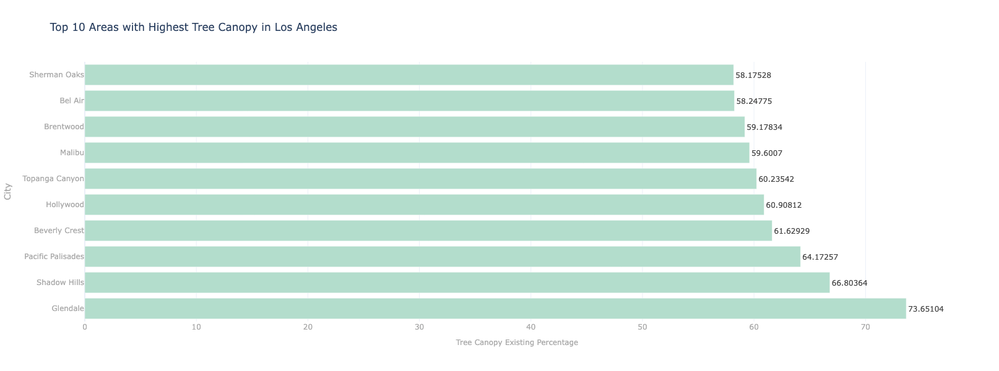

In [16]:
# bar chart
fig = px.bar(top_10_largest.head(10),
        x='Tree Canopy Existing Percentage',
        y='City',
        title="Top 10 Areas with Highest Tree Canopy in Los Angeles", # title
        text_auto = True,
        height=600,
        width=1000,
        color_discrete_sequence =['#B3DDCC']*len(top_10_largest), # single color for all the bars
        labels={
                'count': 'Number of buildngs',
                'building': 'Type of building',
        })

# bar label
fig.update_traces(textposition='outside',textfont_size=12,textfont_color='#444')

# axes labels
fig.update_yaxes(title_font_size=14,title_font_color='#aaa',tickfont_color='#aaa',tickfont_size=12)
fig.update_xaxes(title_font_size=12,title_font_color='#aaa',tickfont_color='#aaa',tickfont_size=12)

# show the figure
fig.show()

In [17]:
lowest_10_values = df2.sort_values(by='Tree Canopy Existing Percentage', ascending=True).head(10)
print(lowest_10_values)

             Fips         City  Tree Canopy Existing Percentage
2320  06037532400       Vernon                         1.296344
615   06037980002       Carson                         1.391016
2617  06037209402     Westlake                         1.427026
908   06037980033   Long Beach                         1.450981
2694  06037206200     Downtown                         1.495012
904   06037980014   Wilmington                         1.518118
462   06037206031    Wholesale                         1.988370
1258  06037980028  Westchester                         2.214517
1088  06037226002     Downtown                         2.260621
907   06037980031    San Pedro                         2.321771


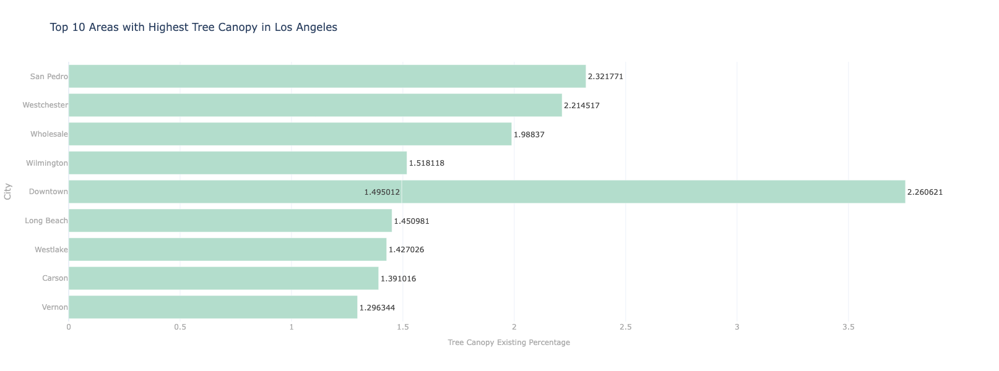

In [18]:
# bar chart
fig = px.bar(lowest_10_values.head(10),
        x='Tree Canopy Existing Percentage',
        y='City',
        title="Top 10 Areas with Highest Tree Canopy in Los Angeles", # title
        text_auto = True,
        height=600,
        width=1000,
        color_discrete_sequence =['#B3DDCC']*len(top_10_largest), # single color for all the bars
        labels={
                'count': 'Number of buildngs',
                'building': 'Type of building',
        })

# bar label
fig.update_traces(textposition='outside',textfont_size=12,textfont_color='#444')

# axes labels
fig.update_yaxes(title_font_size=14,title_font_color='#aaa',tickfont_color='#aaa',tickfont_size=12)
fig.update_xaxes(title_font_size=12,title_font_color='#aaa',tickfont_color='#aaa',tickfont_size=12)

# show the figure
fig.show()

In [19]:
import geopandas as gpd

In [20]:
#data download from tiger/
#data dowloaded from tiger/line
caTracts=gpd.read_file('data/tl_2022_06_tract.zip')
caTracts.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
0,06,037,137504,06037137504,1375.04,Census Tract 1375.04,G5020,S,3837562,0,+34.1480383,-118.5720594,"POLYGON ((-118.58119 34.14318, -118.58099 34.1..."
1,06,037,138000,06037138000,1380,Census Tract 1380,G5020,S,4472196,0,+34.1488008,-118.5910495,"POLYGON ((-118.60573 34.14585, -118.60561 34.1..."
2,06,037,139200,06037139200,1392,Census Tract 1392,G5020,S,1152028,0,+34.1756961,-118.5246446,"POLYGON ((-118.53082 34.18024, -118.52952 34.1..."
3,06,087,120901,06087120901,1209.01,Census Tract 1209.01,G5020,S,18372491,0,+37.0781624,-122.0154263,"POLYGON ((-122.04607 37.07105, -122.04505 37.0..."
4,06,087,120902,06087120902,1209.02,Census Tract 1209.02,G5020,S,6474889,0,+37.0628452,-122.0106243,"POLYGON ((-122.02513 37.0432, -122.025 37.0432..."


In [21]:
#subset caTracts where COUNTYFP equals '037'
la_tracts=caTracts[caTracts['COUNTYFP']=='037']
la_tracts.head()

,STATEFP,COUNTYFP,TRACTCE,GEOID,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
0,06,037,137504,06037137504,1375.04,Census Tract 1375.04,G5020,S,3837562,0,+34.1480383,-118.5720594,"POLYGON ((-118.58119 34.14318, -118.58099 34.1..."
1,06,037,138000,06037138000,1380,Census Tract 1380,G5020,S,4472196,0,+34.1488008,-118.5910495,"POLYGON ((-118.60573 34.14585, -118.60561 34.1..."
2,06,037,139200,06037139200,1392,Census Tract 1392,G5020,S,1152028,0,+34.1756961,-118.5246446,"POLYGON ((-118.53082 34.18024, -118.52952 34.1..."
26,06,037,143200,06037143200,1432,Census Tract 1432,G5020,S,957092,0,+34.1494399,-118.3720618,"POLYGON ((-118.37899 34.15409, -118.37888 34.1..."
27,06,037,201301,06037201301,2013.01,Census Tract 2013.01,G5020,S,866189,0,+34.0882421,-118.1878388,"POLYGON ((-118.19304 34.0859, -118.19294 34.08..."


In [22]:
#create new data frame with geoid and geometry
la_tracts=la_tracts[['GEOID', 'geometry']]
la_tracts.head()

,GEOID,geometry
0,06037137504,"POLYGON ((-118.58119 34.14318, -118.58099 34.1..."
1,06037138000,"POLYGON ((-118.60573 34.14585, -118.60561 34.1..."
2,06037139200,"POLYGON ((-118.53082 34.18024, -118.52952 34.1..."
26,06037143200,"POLYGON ((-118.37899 34.15409, -118.37888 34.1..."
27,06037201301,"POLYGON ((-118.19304 34.0859, -118.19294 34.08..."


In [23]:
#rename GEOID to Fips to match other dataset column
la_tracts.rename(columns={'GEOID': 'Fips'}, inplace=True)
la_tracts.head()

,Fips,geometry
0,06037137504,"POLYGON ((-118.58119 34.14318, -118.58099 34.1..."
1,06037138000,"POLYGON ((-118.60573 34.14585, -118.60561 34.1..."
2,06037139200,"POLYGON ((-118.53082 34.18024, -118.52952 34.1..."
26,06037143200,"POLYGON ((-118.37899 34.15409, -118.37888 34.1..."
27,06037201301,"POLYGON ((-118.19304 34.0859, -118.19294 34.08..."


In [24]:
#create a new dataframe based on the join
tracts_tree=pd.merge(la_tracts, df2, on='Fips')
tracts_tree.head()

,Fips,geometry,City,Tree Canopy Existing Percentage
0,06037137504,"POLYGON ((-118.58119 34.14318, -118.58099 34.1...",Woodland Hills,30.562925
1,06037138000,"POLYGON ((-118.60573 34.14585, -118.60561 34.1...",Woodland Hills,34.899442
2,06037138000,"POLYGON ((-118.60573 34.14585, -118.60561 34.1...",Woodland Hills,33.835898
3,06037138000,"POLYGON ((-118.60573 34.14585, -118.60561 34.1...",Woodland Hills,28.695348
4,06037139200,"POLYGON ((-118.53082 34.18024, -118.52952 34.1...",Encino,22.877822


In [25]:
import folium

In [26]:
# import branca library
import branca
import branca.colormap as cm

In [27]:
# create custom color scheme 
colormap = cm.LinearColormap(
    vmin=tracts_tree["Tree Canopy Existing Percentage"].quantile(0.0),
    vmax=tracts_tree["Tree Canopy Existing Percentage"].quantile(1),
    colors=["#ffffcc", "#c2e699", "#78c679", "#31a354", "#006837"],
    caption="Tree Canopy Existing Percentage",
)

In [28]:
# using branca and folium documentation to display graduate color map with custom popups 
m= folium.Map(location=[34.2, -118.2], zoom_start=9, tiles ='CartoDB positron', attribution = 'CartoDB')

#create popup 
popup = folium .GeoJsonPopup(
    fields=["Fips", "City", "Tree Canopy Existing Percentage"],
    aliases=["Fips", "City", "Tree Canopy Existing Percentage"],
    localize=True,
    labels=True,
    style="background-color:yellow;",
)

#Create custom tooltip 
tooltip = folium.GeoJsonTooltip(
    fields=["Fips", "City", "Tree Canopy Existing Percentage"],
    aliases=["Fips", "City", "Tree Canopy Existing Percentage"],
    localize=True,
    sticky=False,
    Labels=True,
    style="""
    background-color: #F0EFEF;
    border: 2px solid black;
    border-radius:3px;
    box-shadow: 3px;
    """,
    max_width=800,
)

#plot geojson color map with custom line weight 
g=folium.GeoJson(
    tracts_tree,
    style_function=lambda x: {
        "fillColor": colormap(x["properties"]["Tree Canopy Existing Percentage"])
        if x["properties"]["Tree Canopy Existing Percentage"] is not None 
        else "transparent", 
        "color": "black",
        "weight": .1,
        "fillOpacity": 0.4,
    },
    tooltip=tooltip,
    popup=popup,
).add_to(m)

#add color map to variable to map 
colormap.add_to(m)
m

In [32]:
m.save("Tree Canopy Existing Percentage.html")

In [33]:
import os
print(os.getcwd())

/home/jovyan/221finalproject


In [34]:
top_10_largest1 = tracts_tree.sort_values(by='Tree Canopy Existing Percentage', ascending=False).head(10)
print(top_10_largest1)

             Fips                                           geometry  \
1411  06037300701  POLYGON ((-118.29276 34.22165, -118.29187 34.2...   
1846  06037980020  POLYGON ((-118.34412 34.21411, -118.34409 34.2...   
1003  06037980019  POLYGON ((-118.59919 34.07436, -118.59918 34.0...   
2303  06037261200  POLYGON ((-118.45944 34.13048, -118.4593 34.13...   
764   06037194300  POLYGON ((-118.39651 34.09618, -118.39587 34.0...   
82    06037800506  POLYGON ((-118.65342 34.07002, -118.65312 34.0...   
664   06037262400  POLYGON ((-118.52146 34.11764, -118.5214 34.11...   
757   06037262100  POLYGON ((-118.46822 34.12921, -118.46817 34.1...   
1488  06037143902  POLYGON ((-118.42908 34.13457, -118.42905 34.1...   
758   06037262100  POLYGON ((-118.46822 34.12921, -118.46817 34.1...   

                   City  Tree Canopy Existing Percentage  
1411           Glendale                        73.651043  
1846       Shadow Hills                        66.803635  
1003  Pacific Palisades       

In [35]:
# using branca and folium documentation to display graduate color map with custom popups 
m2= folium.Map(location=[34.2, -118.2], zoom_start=9, tiles ='CartoDB positron', attribution = 'CartoDB')

#create popup 
popup = folium .GeoJsonPopup(
    fields=["Fips", "City", "Tree Canopy Existing Percentage"],
    aliases=["Fips", "City", "Tree Canopy Existing Percentage"],
    localize=True,
    labels=True,
    style="background-color:yellow;",
)

#Create custom tooltip 
tooltip = folium.GeoJsonTooltip(
    fields=["Fips", "City", "Tree Canopy Existing Percentage"],
    aliases=["Fips", "City", "Tree Canopy Existing Percentage"],
    localize=True,
    sticky=False,
    Labels=True,
    style="""
    background-color: #F0EFEF;
    border: 2px solid black;
    border-radius:3px;
    box-shadow: 3px;
    """,
    max_width=800,
)

#plot geojson color map with custom line weight 
g2=folium.GeoJson(
    top_10_largest1,
    style_function=lambda x: {
        "fillColor": colormap(x["properties"]["Tree Canopy Existing Percentage"])
        if x["properties"]["Tree Canopy Existing Percentage"] is not None 
        else "transparent", 
        "color": "black",
        "weight": .1,
        "fillOpacity": 0.4,
    },
    tooltip=tooltip,
    popup=popup,
).add_to(m2)

#add color map to variable to map 
colormap.add_to(m2)
m2

In [36]:
lowest_10_values1 = tracts_tree.sort_values(by='Tree Canopy Existing Percentage', ascending=True).head(10)
print(lowest_10_values)

             Fips         City  Tree Canopy Existing Percentage
2320  06037532400       Vernon                         1.296344
615   06037980002       Carson                         1.391016
2617  06037209402     Westlake                         1.427026
908   06037980033   Long Beach                         1.450981
2694  06037206200     Downtown                         1.495012
904   06037980014   Wilmington                         1.518118
462   06037206031    Wholesale                         1.988370
1258  06037980028  Westchester                         2.214517
1088  06037226002     Downtown                         2.260621
907   06037980031    San Pedro                         2.321771


In [37]:
# using branca and folium documentation to display graduate color map with custom popups 
m3= folium.Map(location=[34.2, -118.2], zoom_start=9, tiles ='CartoDB positron', attribution = 'CartoDB')

#create popup 
popup = folium .GeoJsonPopup(
    fields=["Fips", "City", "Tree Canopy Existing Percentage"],
    aliases=["Fips", "City", "Tree Canopy Existing Percentage"],
    localize=True,
    labels=True,
    style="background-color:yellow;",
)

#Create custom tooltip 
tooltip = folium.GeoJsonTooltip(
    fields=["Fips", "City", "Tree Canopy Existing Percentage"],
    aliases=["Fips", "City", "Tree Canopy Existing Percentage"],
    localize=True,
    sticky=False,
    Labels=True,
    style="""
    background-color: #F0EFEF;
    border: 2px solid black;
    border-radius:3px;
    box-shadow: 3px;
    """,
    max_width=800,
)

#plot geojson color map with custom line weight 
g3=folium.GeoJson(
    lowest_10_values1,
    style_function=lambda x: {
        "fillColor": colormap(x["properties"]["Tree Canopy Existing Percentage"])
        if x["properties"]["Tree Canopy Existing Percentage"] is not None 
        else "transparent", 
        "color": "black",
        "weight": .1,
        "fillOpacity": 0.4,
    },
    tooltip=tooltip,
    popup=popup,
).add_to(m3)

#add color map to variable to map 
colormap.add_to(m3)
m3

NameError: name 'clip' is not defined

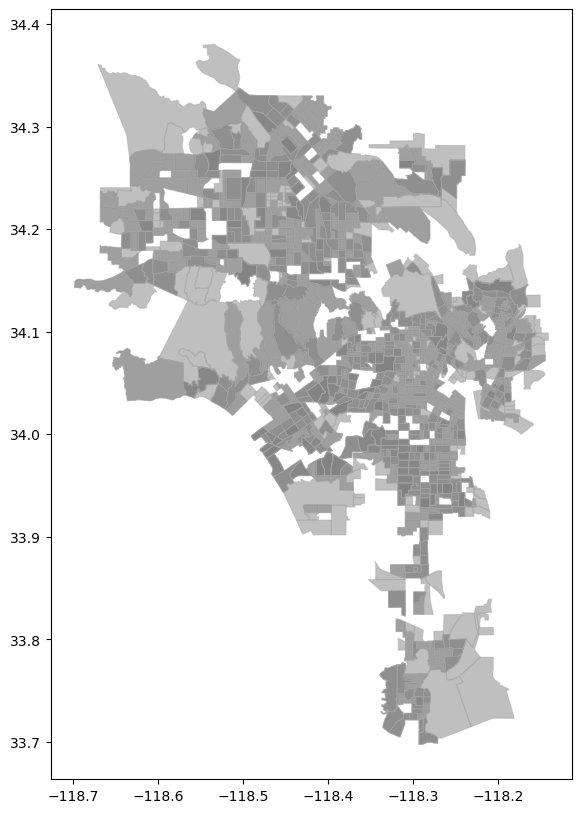

In [38]:
import geopandas as pd

%matplotlib inline
import matplotlib.pyplot as plt 

# Plot la_tracts and clip
fig, ax = plt.subplots(figsize=(10, 10))

# Plot LA tracts with opaque grey fill and dark grey skinny edge color
tracts_tree.plot(ax=ax, color='grey', edgecolor='darkgrey', alpha=0.5, linewidth=0.75)

# Plot the clip boundary with black color
clip.boundary.plot(ax=ax, color='black', linewidth=1)

plt.title('LA Tracts and County Boundary')
plt.show()

In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt

# Set fig, ax and plot with legend outside of plot
fig, ax = plt.subplots(figsize=(10, 10))
tracts_tree.plot(column="Tree Canopy Existing Percentage", scheme="Natural_Breaks", k=5, cmap="YlGn", linewidth=0, legend=True, ax=ax)

# Use tight layout
plt.tight_layout()
plt.title('Tree Canopy Existing Percentage')

ax.axis('off')

# Place legend outside of plot
ax.get_legend().set_bbox_to_anchor((1.5, 1))

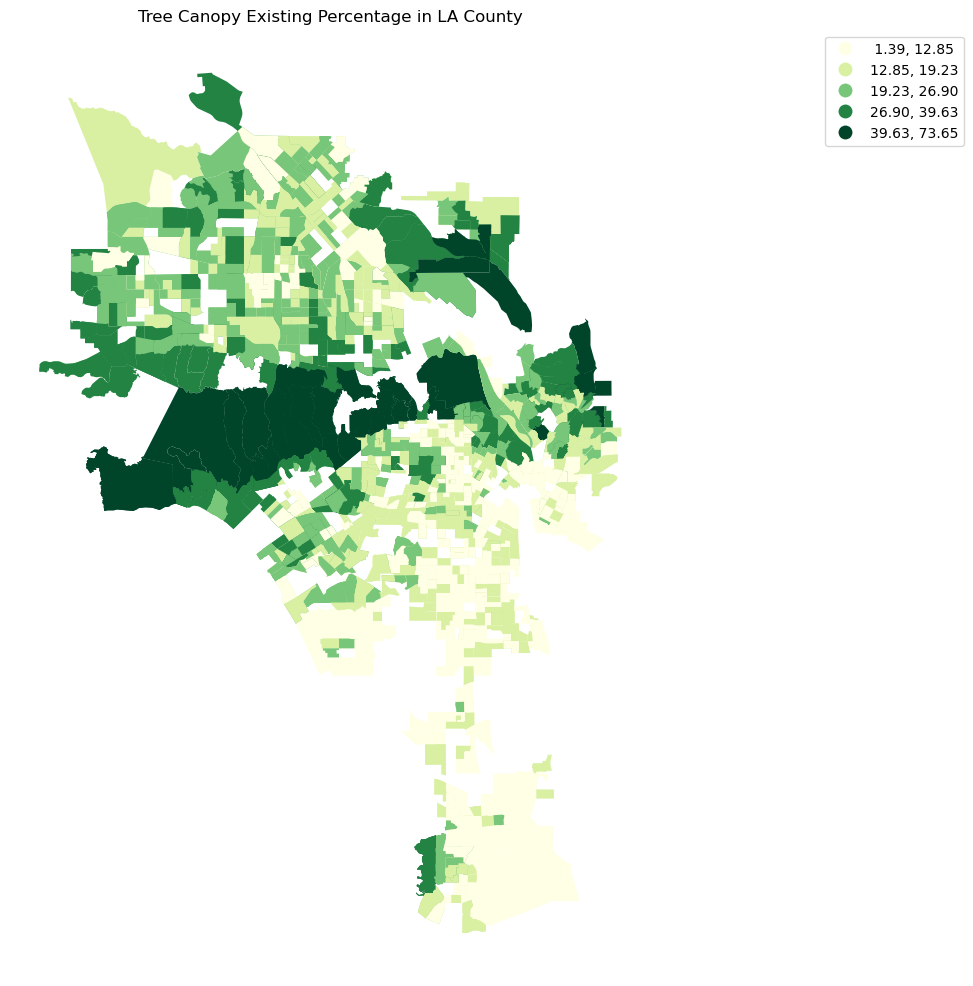

In [39]:
# Plot using 5 classes and classify the values using "Natural Breaks" classification
fig, ax = plt.subplots(figsize=(10, 10))
tracts_tree.plot(column="Tree Canopy Existing Percentage", scheme="Natural_Breaks", k=5, cmap="YlGn", linewidth=0, legend=True, ax = ax)

# Use tight layout
plt.tight_layout()
plt.title('Tree Canopy Existing Percentage in LA County')

ax.axis('off')

# Place legend outside of plot
ax.get_legend().set_bbox_to_anchor((1.5, 1))

In [40]:
import mapclassify

In [41]:
mapclassify.NaturalBreaks(y=tracts_tree['Tree Canopy Existing Percentage'], k=5)

NaturalBreaks

   Interval      Count
----------------------
[ 1.39, 12.82] |   668
(12.82, 19.23] |   778
(19.23, 26.99] |   631
(26.99, 40.08] |   277
(40.08, 73.65] |    74

In [42]:
mapclassify.Quantiles(y=tracts_tree['Tree Canopy Existing Percentage'])

Quantiles

   Interval      Count
----------------------
[ 1.39, 11.63] |   486
(11.63, 15.08] |   485
(15.08, 19.34] |   486
(19.34, 24.69] |   485
(24.69, 73.65] |   486

In [43]:
classifier = mapclassify.NaturalBreaks(y=tracts_tree['Tree Canopy Existing Percentage'], k=5)
classifier.bins

array([12.88561635, 19.36759053, 27.13801553, 40.07500132, 73.65104293])

In [44]:
# Create a Natural Breaks classifier
classifier = mapclassify.NaturalBreaks.make(k=5)

In [45]:
# Classify the data
classifications = tracts_tree[['Tree Canopy Existing Percentage']].apply(classifier)

# Let's see what we have
classifications.head()

,Tree Canopy Existing Percentage
0,3
1,3
2,3
3,3
4,2


In [46]:
type(classifications)

pandas.core.frame.DataFrame

In [47]:
# Rename the column so that we know that it was classified with natural breaks
tracts_tree['Tree Canopy Class'] = tracts_tree[['Tree Canopy Existing Percentage']].apply(classifier)

# Check the original values and classification
tracts_tree[['Tree Canopy Class', 'Tree Canopy Existing Percentage']].head()

,Tree Canopy Class,Tree Canopy Existing Percentage
0,3,30.562925
1,3,34.899442
2,3,33.835898
3,3,28.695348
4,2,22.877822


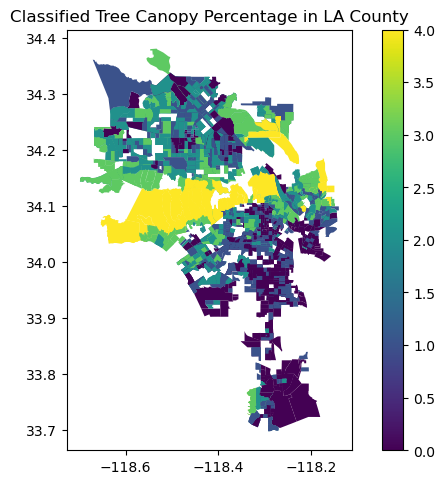

In [48]:
# Plot
tracts_tree.plot(column="Tree Canopy Class", linewidth=0, legend=True)

# Use tight layout
plt.tight_layout()
plt.title('Classified Tree Canopy Percentage in LA County')
plt.set_cmap('YlGn')

<Axes: ylabel='Frequency'>

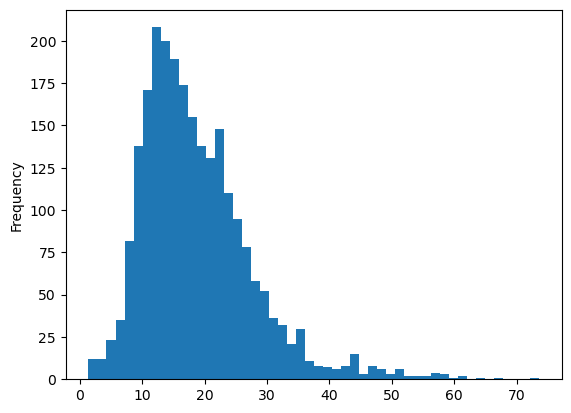

In [49]:
# Histogram for tree canopy
tracts_tree['Tree Canopy Existing Percentage'].plot.hist(bins=50)

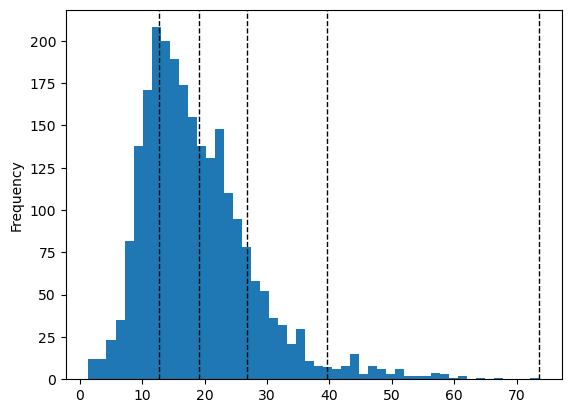

In [50]:
# Define classifier
classifier = mapclassify.NaturalBreaks(y=tracts_tree['Tree Canopy Existing Percentage'], k=5)

# Plot histogram for public transport rush hour travel time
tracts_tree['Tree Canopy Existing Percentage'].plot.hist(bins=50)

# Add vertical lines for class breaks
for value in classifier.bins:
    plt.axvline(value, color='k', linestyle='dashed', linewidth=1)

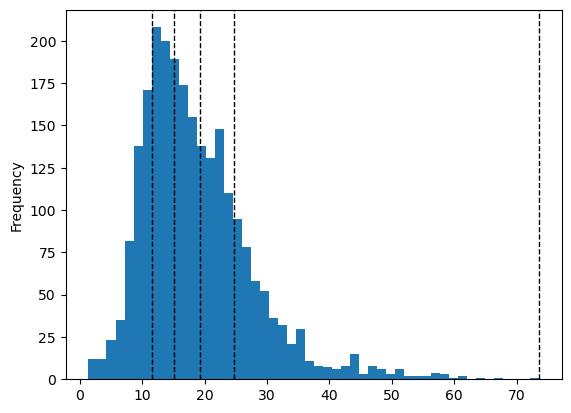

In [51]:
# Define classifier
classifier = mapclassify.Quantiles(y=tracts_tree['Tree Canopy Existing Percentage'])

# Plot histogram for public transport rush hour travel time
tracts_tree['Tree Canopy Existing Percentage'].plot.hist(bins=50)

for value in classifier.bins:
    plt.axvline(value, color='k', linestyle='dashed', linewidth=1)

In [52]:
# Export merged_tracts to a CSV file
tracts_tree.to_csv('tracts_tree_class.csv', index=False)

In [53]:
# Define classifiers for each column
classifier_tree_canopy = mapclassify.NaturalBreaks(y=tracts_tree['Tree Canopy Existing Percentage'], k=5)

# Apply classifiers and create new columns
tracts_tree['treeCanopy_class'] = tracts_tree[['Tree Canopy Existing Percentage']].apply(classifier_tree_canopy)


# Check the head of the dataframe to see the new columns
print(tracts_tree[['treeCanopy_class']].head())

   treeCanopy_class
0                 3
1                 3
2                 3
3                 3
4                 2


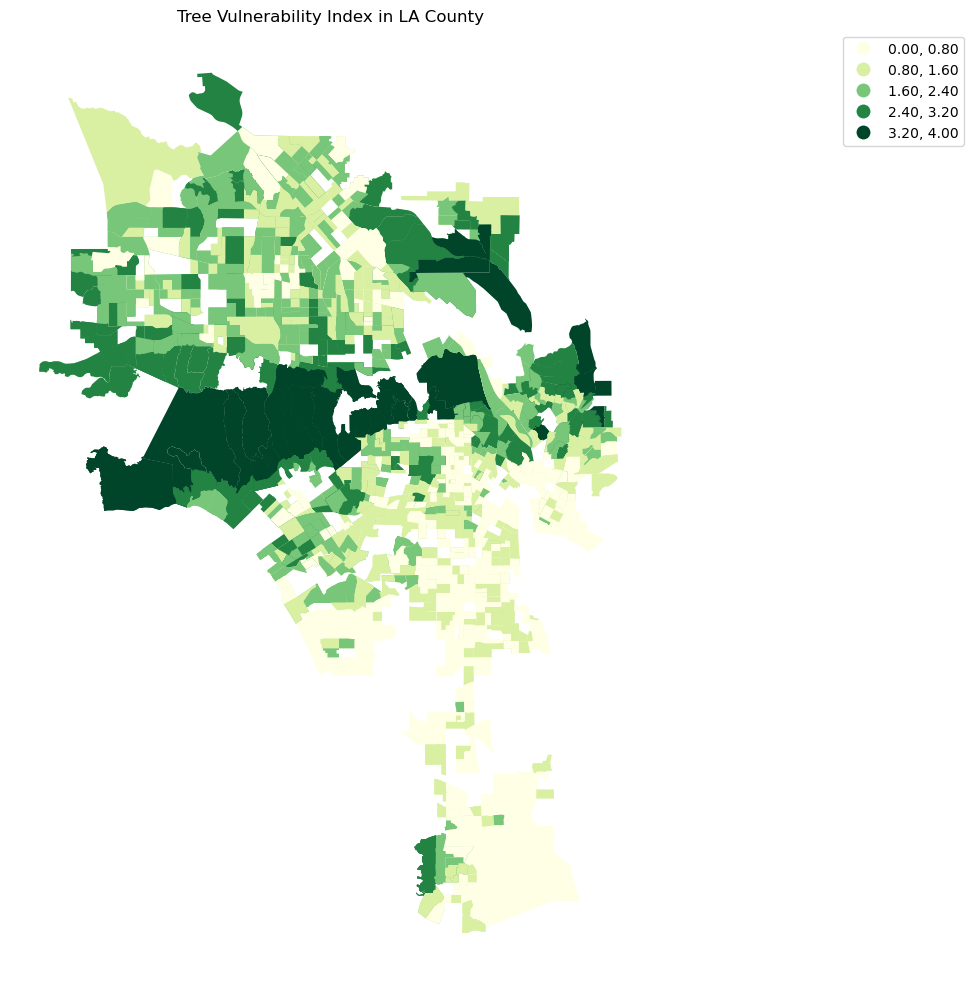

<Figure size 640x480 with 0 Axes>

In [54]:
# Create the 'tree_index' column
tracts_tree['tree_index'] = (
    tracts_tree['treeCanopy_class'] 
)

# Plot the 'housing_transit_index' using equal intervals
fig, ax = plt.subplots(figsize=(10, 10))
tracts_tree.plot(column="tree_index", scheme="Equal_Interval", k=5, cmap="YlGn", linewidth=0, legend=True, ax=ax)

# Use tight layout
plt.tight_layout()
plt.title('Tree Vulnerability Index in LA County')
ax.axis('off')

# Place legend outside of plot
ax.get_legend().set_bbox_to_anchor((1.5, 1))
plt.show()
# Save the plot to a PNG file
plt.savefig('tree_vulnerability_index.png')

In [55]:
import folium
import contextily as ctx
from folium.plugins import HeatMap

# Create a folium map centered around LA County
m = folium.Map(location=[34.0522, -118.2437], zoom_start=8, tiles='cartodbpositron')

# Display the map
folium.Choropleth(
    geo_data=tracts_tree,
    name='choropleth',
    data=tracts_tree,
    columns=['Fips', 'tree_index'],
    key_on='feature.properties.Fips',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Tree Vulnerability Index',
    bins=5,  # Set the number of bins for equal interval classification
    reset=True
).add_to(m)

# Save the map as an HTML file
m.save('tree_index.html')

m 